<div style="background-color: #0B132B; padding: 20px; border-radius: 10px; border: 3px solid #6FFFE9;">
    <br><br>
    <h1 style="color: #5BC0BE; text-align: center; font-size: 36px; margin-bottom: 15px;">GAN Art Creating Kaggle Mini-Project</h1><br>
    <h2 style="color: #4C698D; text-align: center; font-size: 26px; font-weight: bold; margin-top: 0;">by Arne Martin Fevolden (CU Boulder)</h2>
<br><br><br>
</div>

In [1]:
import numpy as np
import pandas as pd
import os
from PIL import Image
import matplotlib.pyplot as plt
import time

import tensorflow as tf
from tensorflow.keras import layers
import shutil

2024-05-05 14:22:51.639762: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-05 14:22:51.639881: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-05 14:22:51.765259: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


<div style="background-color: #0B132B; padding: 25px; border-radius: 8px; border: 2px solid #6FFFE9; margin-top: 0;">
    <h3 style="color: #5BC0BE; text-align: center; font-size: 26px; margin-top: 30; margin-bottom: 30">Brief Description of the Problem and Data</h3>
</div>

The task in this competition is to create 7,000 to 10,000 pictures that Monet-style pictures. That is, the task is to create pictures that look like they could have been pained by Claude Monet and that a trained classifier cannot distinguish as fakes.

The competition comes with a dataset that consists of 300 Monet paintings (sized 256x256 in JPEG format) and 7028 photos (sized 256x256 in JPEG format). The aim is to use the Monet painting to train a GAN (Generative Adversarial Network) to master the style of Monet and use the GAN to style the pictures in a way that they look like they could have been pained by Monet. Alternatively, the GAN can simply generate images in the style of Monet without making use of the pictures, which is the approach we choose for this project.

The dataset also contains copies of the paintings and pictures in the TFRecords format. The TFRecords are supposed to be faster to process for tenosorflow and for that reason we will make use of them in our project.  

<div style="background-color: #0B132B; padding: 25px; border-radius: 8px; border: 2px solid #6FFFE9; margin-top: 0;">
    <h3 style="color: #5BC0BE; text-align: center; font-size: 26px; margin-top: 30; margin-bottom: 30">Exploratory Data Analysis (EDA) — Inspect, Visualize and Clean the Data</h3>
</div>

In this section, we will ...
* verify that we can access all avialable files
* control that there are 300 paintings and 7028 photos
* visually inspect a few paintings and photos
* Comapare the color intensity of paintings and photos

<div style="background-color:#5BC0BE; padding: 15px; border-radius: 8px; border: 2px solid #0B132B; margin-top: 20px;">
    <h3 style="color: #0B132B; text-align: left; font-size: 22px; margin-top: 0;">Useful functions</h3>
</div>

In [2]:
def count_images_in_folder(folder_path):
    """
    Counts the number of image files in a given directory.
    
    Args:
    folder_path (str): The path to the directory containing images.
    
    Returns:
    int: The number of image files in the directory.
    """
    # List of image file extensions you want to check for
    image_extensions = ('.jpg', ) # '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.webp'
    
    # Get a list of files in the directory
    files_in_folder = os.listdir(folder_path)
    
    # Count files that end with any of the image extensions
    image_count = sum(1 for file in files_in_folder if file.lower().endswith(image_extensions))
    
    return image_count

In [3]:
def display_images(path):
    # List all JPEG files in the specified directory
    files = [os.path.join(path, f) for f in os.listdir(path) if f.endswith('.jpg')]
    
    # Select the first 9 images (or fewer if not enough images are available)
    files = files[:9]
    
    # Set up the figure and axes for a 3x3 grid
    fig, axes = plt.subplots(3, 3, figsize=(10, 10))
    axes = axes.ravel()
    
    # Loop over the files and the axes
    for ax, img_path in zip(axes, files):
        # Open and display the image
        img = Image.open(img_path)
        ax.imshow(img)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(os.path.basename(img_path))
    
    # Hide any unused axes if there are less than 9 images
    for ax in axes[len(files):]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()

In [4]:
def compare_image_colors_normalized(path1, path2):
    """
    Compares the normalized average RGB values between two sets of images from different folders,
    using distinct color shades for better visual distinction.

    Args:
    path1 (str): Path to the first directory containing pictures.
    path2 (str): Path to the second directory containing paintings.
    """
    def get_avg_colors(image_folder):
        image_files = [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(('png', 'jpg', 'jpeg'))]
        avg_colors = []
        for file in image_files:
            with Image.open(file) as img:
                img = img.convert('RGB')
                data = np.array(img)
                mean_color = data.mean(axis=(0, 1))
                avg_colors.append(mean_color)
        return np.array(avg_colors)
    
    # Get average colors for both directories
    avg_colors1 = get_avg_colors(path1)  # Pictures
    avg_colors2 = get_avg_colors(path2)  # Paintings
    
    # Plotting
    fig, axes = plt.subplots(3, 1, figsize=(8, 10), sharex=True)
    color_labels = ['Red', 'Green', 'Blue']
    dark_shades = ['darkred', 'darkgreen', 'darkblue']  # Darker shades for pictures
    pastel_shades = ['salmon', 'lightgreen', 'lightblue']  # Pastel shades for paintings
    
    for i in range(3):
        axes[i].hist(avg_colors1[:, i], bins=30, alpha=0.7, label='Pictures', color=dark_shades[i], density=True)
        axes[i].hist(avg_colors2[:, i], bins=30, alpha=0.7, label='Paintings', color=pastel_shades[i], density=True, linestyle='dashed')
        axes[i].set_title(f'Normalized Comparison of {color_labels[i]} Channel')
        axes[i].legend(loc='upper right')

    plt.tight_layout()
    plt.show()


<div style="background-color:#5BC0BE; padding: 15px; border-radius: 8px; border: 2px solid #0B132B; margin-top: 20px;">
    <h3 style="color: #0B132B; text-align: left; font-size: 22px; margin-top: 0;">Investigation</h3>
</div>

In [5]:
# Overview of available files
Input = '/kaggle/input/gan-getting-started'
print(os.listdir(Input))

['monet_jpg', 'photo_tfrec', 'photo_jpg', 'monet_tfrec']


In [6]:
# Count number of pictures
count_images_in_folder(Input + '/photo_jpg')

7038

In [7]:
# Count number of paintings
count_images_in_folder(Input + '/monet_jpg')

300

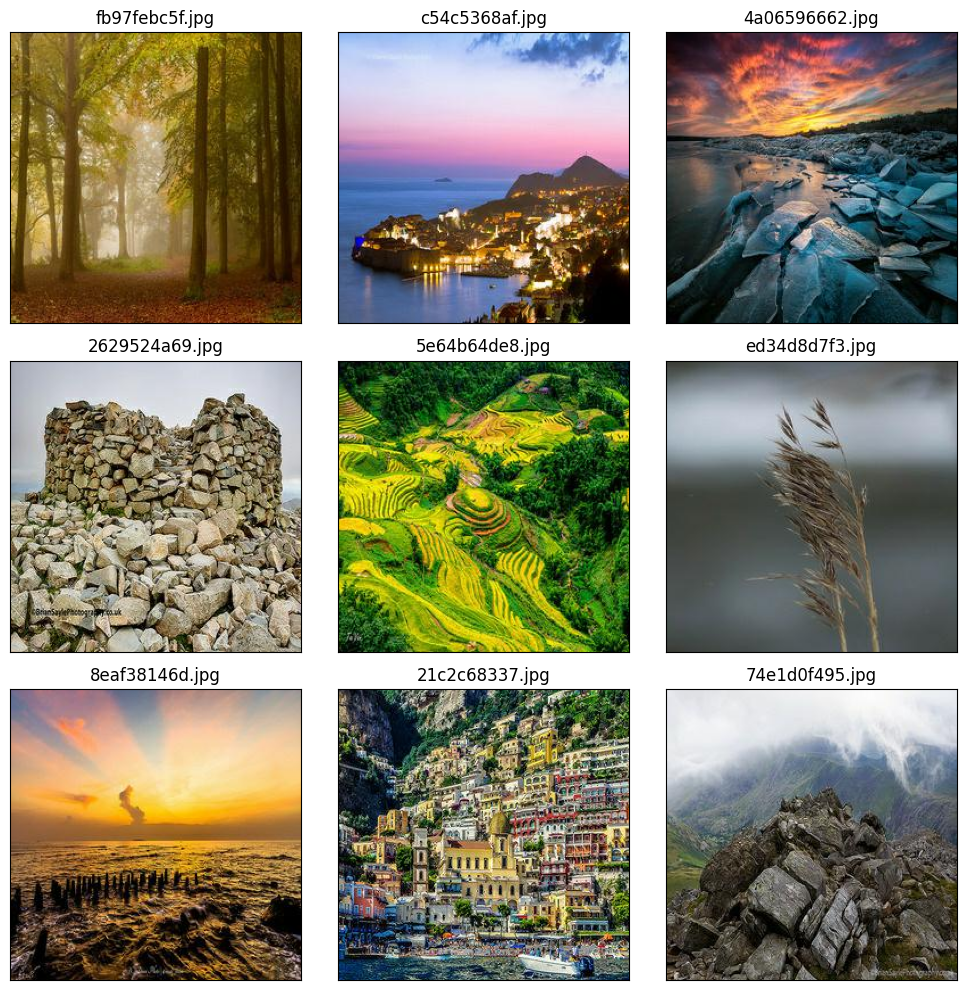

In [8]:
# Photo
display_images(Input + '/photo_jpg')

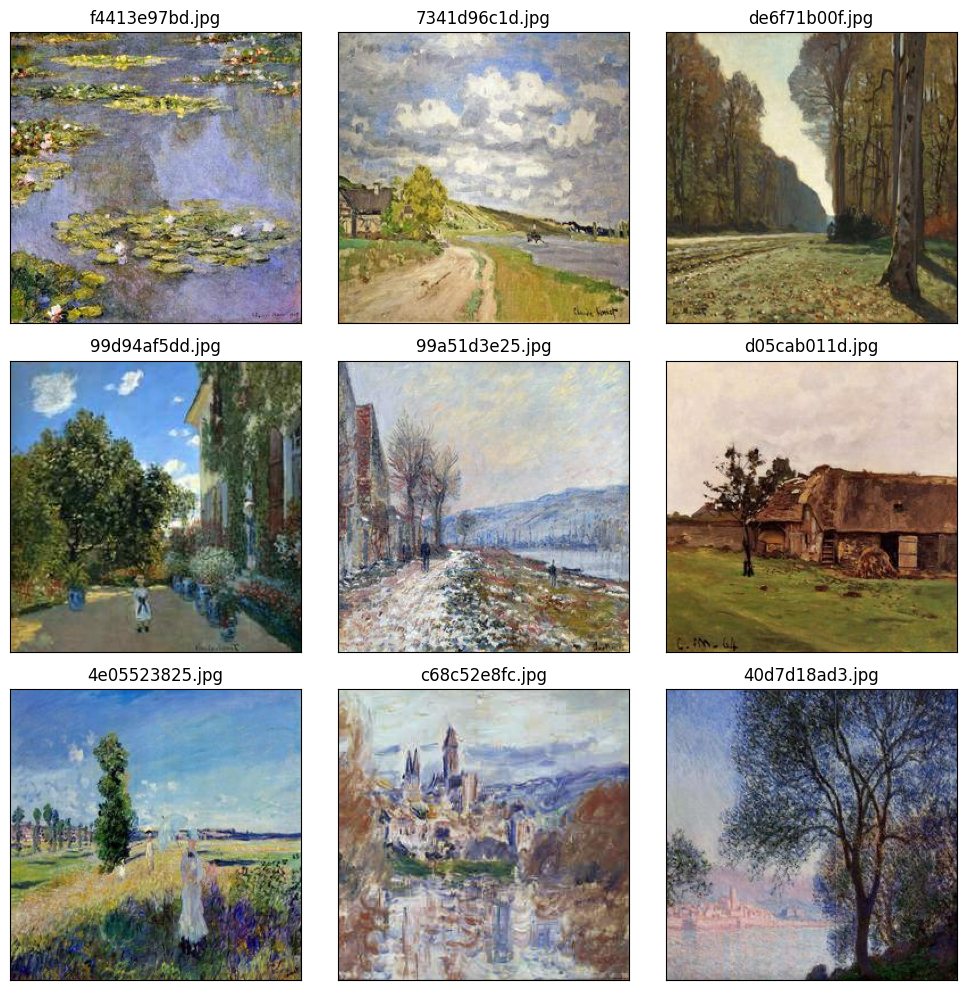

In [9]:
# Monet Paintings
display_images(Input + '/monet_jpg')

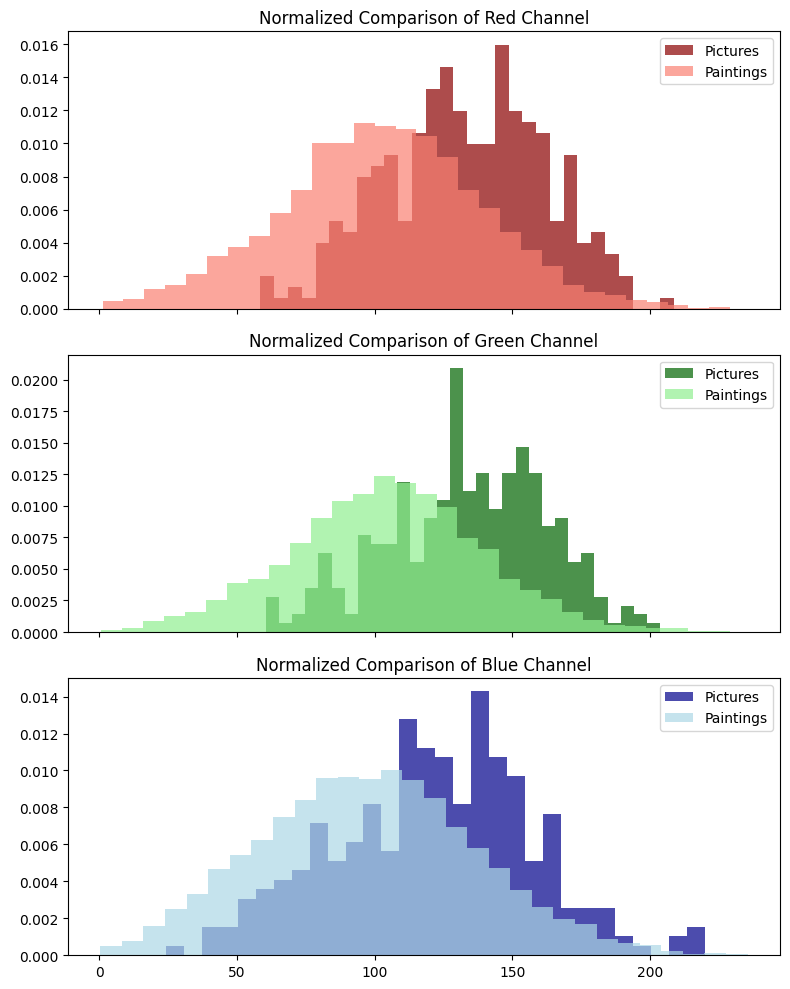

In [10]:
compare_image_colors_normalized(Input + '/monet_jpg', Input + '/photo_jpg')

<div style="background-color:#5BC0BE; padding: 15px; border-radius: 8px; border: 2px solid #0B132B; margin-top: 20px;">
    <h3 style="color: #0B132B; text-align: left; font-size: 22px; margin-top: 0;">Conclusion</h3>
</div>

Based on our investigations, we can conclude that:

* The dataset contains paintings and pictures in the formats jpg and TFrecords
* There are 300 paintings in the dataset as adverticed in the competition, but there are 7038 pictures, which are 10 more that adverticed.
* Visual inspection of images verfied that both the pictures and the paintings looked correct. 
* An analysis of the color intensity found that the pictures in average made use of more intense colors that the paintings. The paintings are a bit muted compared to the pictures

All in all, this implies that there are good reasons to believe that the dataset can be used to train a functioning GAN.

<div style="background-color: #0B132B; padding: 25px; border-radius: 8px; border: 2px solid #6FFFE9; margin-top: 0;">
    <h3 style="color: #5BC0BE; text-align: center; font-size: 26px; margin-top: 30; margin-bottom: 30">Model Architecture</h3>
</div>

This project makes use of a Deep Convolutional Generative Adversarial Network (DCGAN) architecture. The architecture consists of two main pars:

The **Generator**, which takes a random noise vector as input and outputs a synthetic image. The generator tries to produce images that are indistinguishable from real images, effectively "fooling" the discriminator. To accomplish this task, it utilizes a series of transposed convolutional layers to progressively upscale the input vector into a full-sized image.

The **Discriminator** acts as a critic that tries to differentiate between real images (from the dataset) and fake images (produced by the generator). It uses standard convolutional layers to downsample the input image and makes a decision on its authenticity.

During training the generator tries to maximize the error rate of the discriminator (by improving the quality of the fake images), while the discriminator tries to minimize its own error rate. This adversarial process drives both networks to improve continuously, with the generator producing increasingly Monet-like painings and the discriminator becoming better at detecting subtleties between real and fake paintings. The training alternates between updating the discriminator with real and fake images, and updating the generator based on the feedback from the discriminator.

<div style="background-color:#5BC0BE; padding: 15px; border-radius: 8px; border: 2px solid #0B132B; margin-top: 20px;">
    <h3 style="color: #0B132B; text-align: left; font-size: 22px; margin-top: 0;">Data handeling functions</h3>
</div>

In [11]:
# Define the function to parse TFRecords
def _parse_function(proto):
    features = {
        'image': tf.io.FixedLenFeature([], tf.string),
    }
    parsed_features = tf.io.parse_single_example(proto, features)
    image = tf.io.decode_jpeg(parsed_features['image'], channels=3)
    image = tf.cast(image, tf.float32)
    image = (image - 127.5) / 127.5
    image = tf.reshape(image, [256, 256, 3])
    return image

# Load the dataset from TFRecords
def load_dataset(tfrecord_files, batch_size):
    dataset = tf.data.TFRecordDataset(tfrecord_files)
    dataset = dataset.map(_parse_function, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.shuffle(buffer_size=10000)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    return dataset

<div style="background-color:#5BC0BE; padding: 15px; border-radius: 8px; border: 2px solid #0B132B; margin-top: 20px;">
    <h3 style="color: #0B132B; text-align: left; font-size: 22px; margin-top: 0;">GAN model</h3>
</div>

/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/dense.py:86: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(
2024-05-05 14:24:14.983008: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1_2/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


Epoch 1, gen_loss=1.9970, disc_loss=1.0214, time=19.87 sec


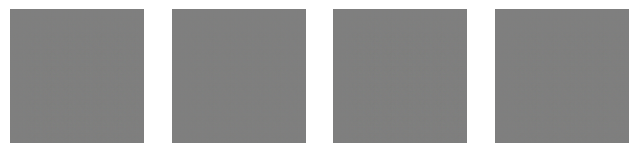

Epoch 20, gen_loss=1.9302, disc_loss=0.7864, time=3.55 sec


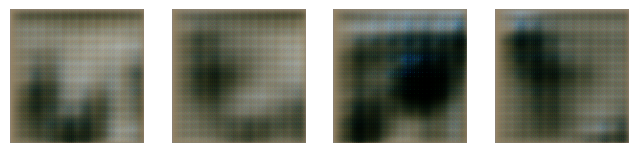

Epoch 40, gen_loss=2.2393, disc_loss=0.6811, time=3.54 sec


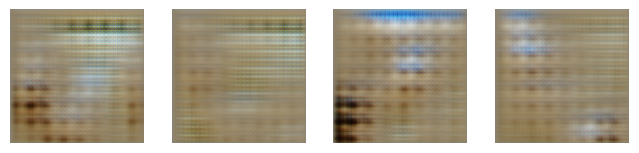

Epoch 60, gen_loss=2.1273, disc_loss=0.6648, time=3.55 sec


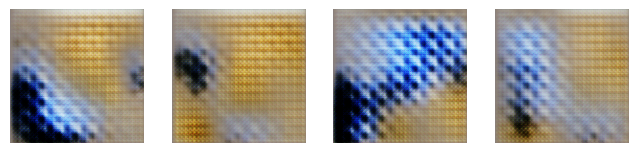

Epoch 80, gen_loss=2.5268, disc_loss=0.5439, time=3.54 sec


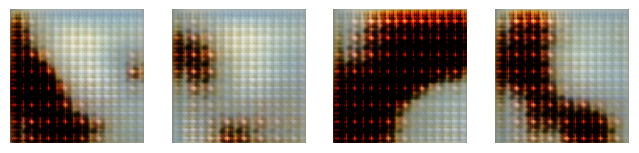

Epoch 100, gen_loss=6.1429, disc_loss=0.8124, time=3.54 sec


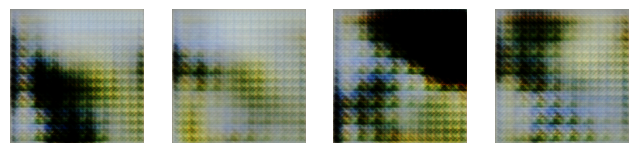

Epoch 120, gen_loss=3.0442, disc_loss=0.4701, time=3.53 sec


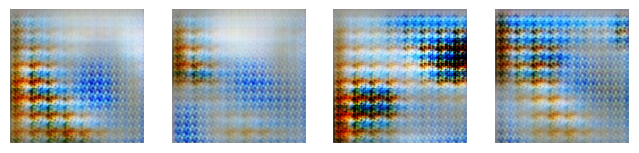

Epoch 140, gen_loss=2.9726, disc_loss=0.1835, time=3.53 sec


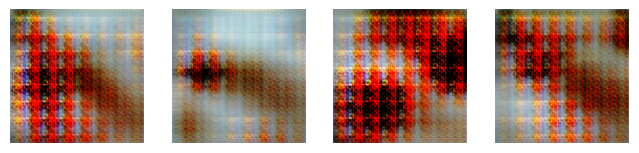

Epoch 160, gen_loss=2.8527, disc_loss=0.3013, time=3.57 sec


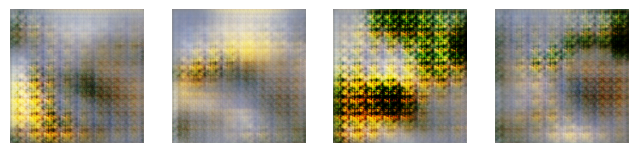

Epoch 180, gen_loss=4.4865, disc_loss=0.4693, time=3.53 sec


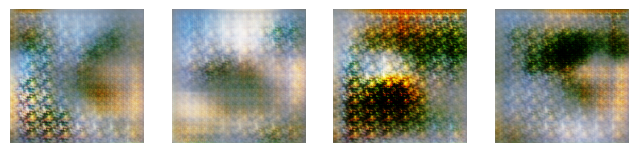

Epoch 200, gen_loss=6.9555, disc_loss=0.6640, time=3.53 sec


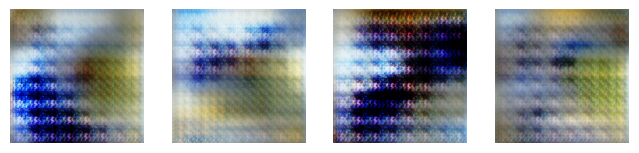

Epoch 220, gen_loss=3.7675, disc_loss=0.3965, time=3.54 sec


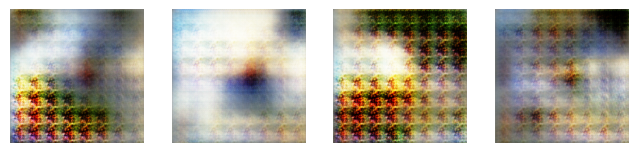

Epoch 240, gen_loss=4.7271, disc_loss=0.6096, time=3.53 sec


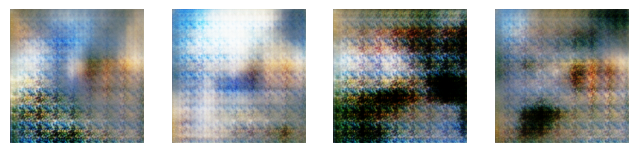

Epoch 260, gen_loss=2.8810, disc_loss=0.4437, time=3.53 sec


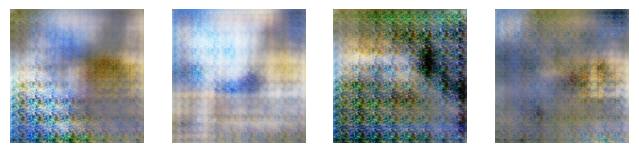

Epoch 280, gen_loss=3.3816, disc_loss=0.6066, time=3.55 sec


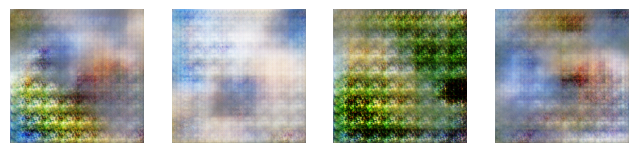

Epoch 300, gen_loss=4.3756, disc_loss=0.8920, time=3.56 sec


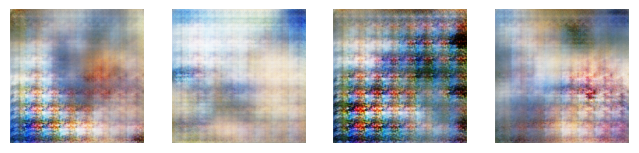

Epoch 320, gen_loss=4.4554, disc_loss=0.6609, time=3.53 sec


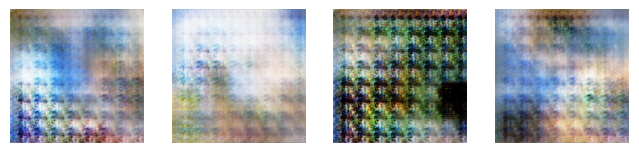

Epoch 340, gen_loss=2.7567, disc_loss=0.5196, time=3.54 sec


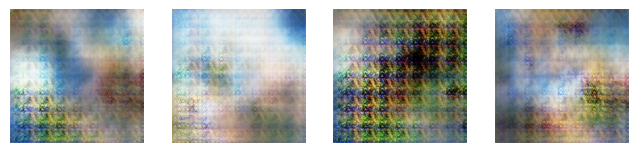

Epoch 360, gen_loss=2.5987, disc_loss=0.8876, time=3.53 sec


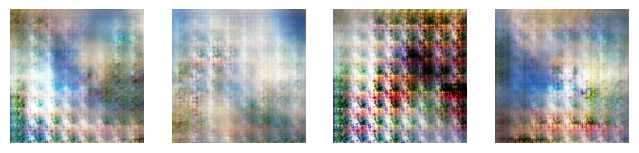

Epoch 380, gen_loss=3.1584, disc_loss=0.6179, time=3.53 sec


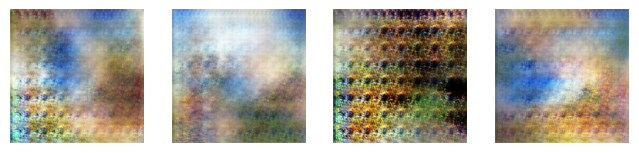

Epoch 400, gen_loss=2.5822, disc_loss=0.5573, time=3.54 sec


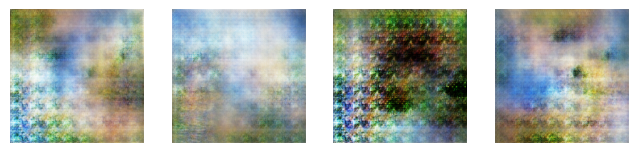

Epoch 420, gen_loss=2.8049, disc_loss=0.7731, time=3.54 sec


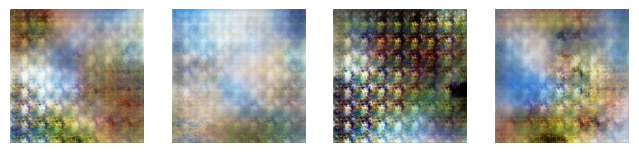

Epoch 440, gen_loss=2.8463, disc_loss=0.7331, time=3.54 sec


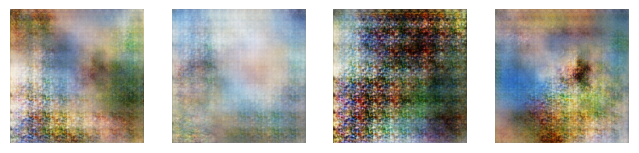

Epoch 460, gen_loss=2.7771, disc_loss=0.6515, time=3.53 sec


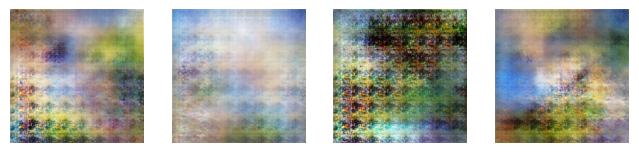

Epoch 480, gen_loss=2.9793, disc_loss=0.5611, time=3.53 sec


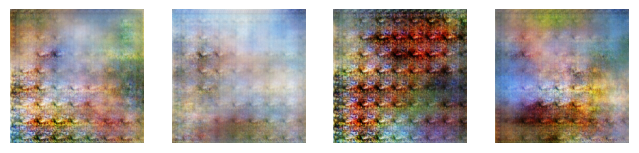

Epoch 500, gen_loss=3.2516, disc_loss=0.5671, time=3.54 sec


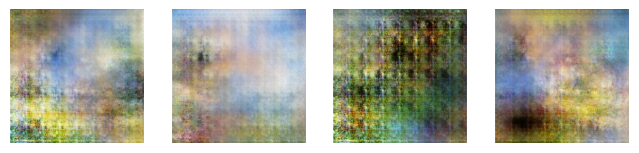

Epoch 520, gen_loss=3.1777, disc_loss=0.5339, time=3.53 sec


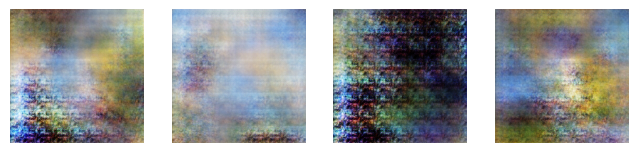

Epoch 540, gen_loss=2.8622, disc_loss=0.3856, time=3.54 sec


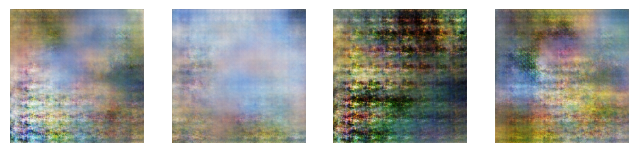

Epoch 560, gen_loss=4.3922, disc_loss=0.5707, time=3.55 sec


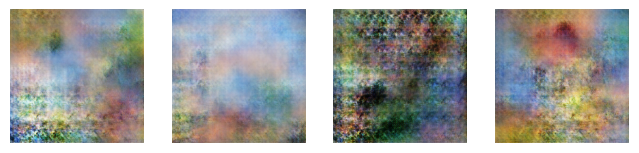

Epoch 580, gen_loss=4.5312, disc_loss=0.7055, time=3.53 sec


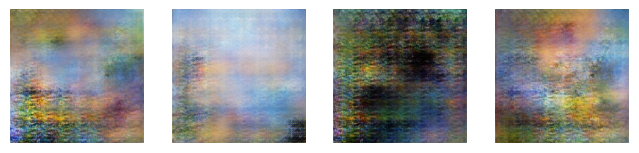

Epoch 600, gen_loss=3.0518, disc_loss=0.4574, time=3.53 sec


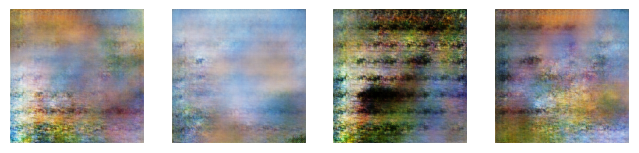

Epoch 620, gen_loss=3.8908, disc_loss=0.3488, time=3.53 sec


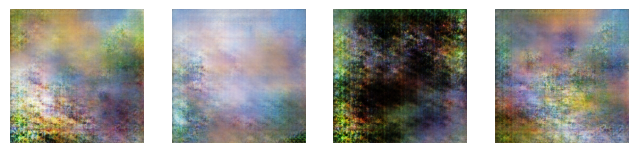

Epoch 640, gen_loss=3.4580, disc_loss=0.5580, time=3.53 sec


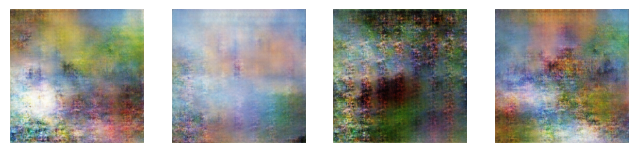

Epoch 660, gen_loss=3.3911, disc_loss=0.3259, time=3.53 sec


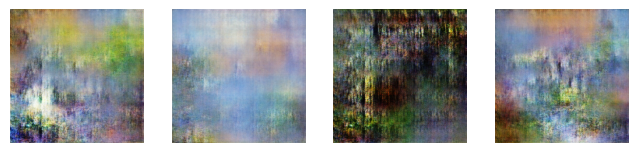

Epoch 680, gen_loss=3.4154, disc_loss=0.4909, time=3.58 sec


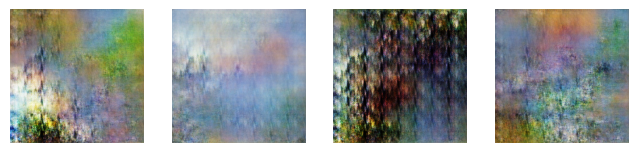

Epoch 700, gen_loss=5.1956, disc_loss=0.2392, time=3.54 sec


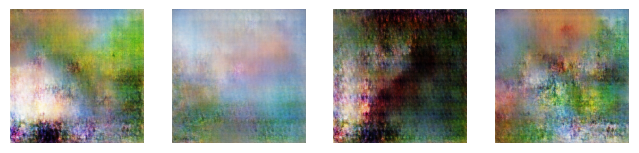

Epoch 720, gen_loss=3.9035, disc_loss=0.4675, time=3.53 sec


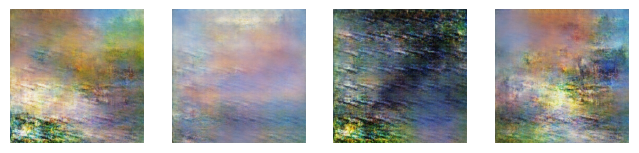

Epoch 740, gen_loss=3.4649, disc_loss=0.3897, time=3.53 sec


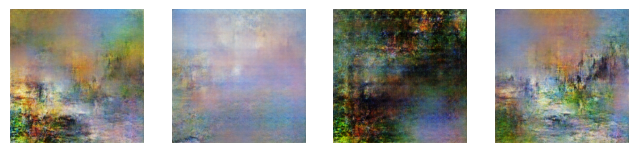

Epoch 760, gen_loss=3.4921, disc_loss=0.2736, time=3.52 sec


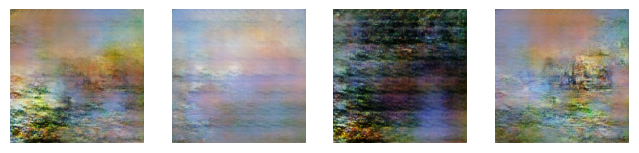

Epoch 780, gen_loss=4.9438, disc_loss=0.5764, time=3.53 sec


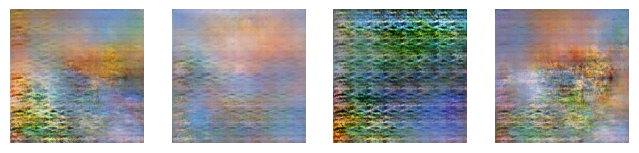

Epoch 800, gen_loss=7.5120, disc_loss=1.8998, time=3.54 sec


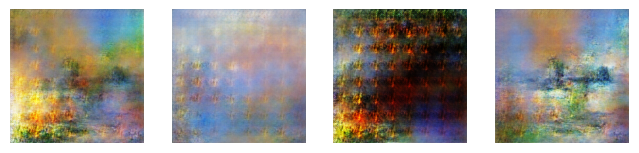

Epoch 820, gen_loss=5.1424, disc_loss=0.2872, time=3.54 sec


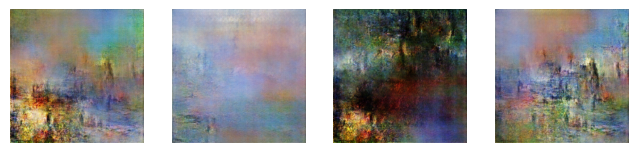

Epoch 840, gen_loss=3.8622, disc_loss=0.2763, time=3.54 sec


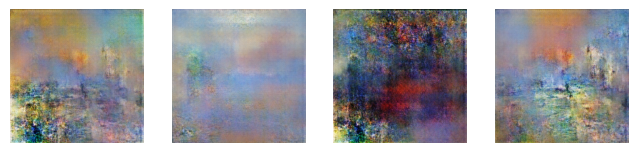

Epoch 860, gen_loss=5.8688, disc_loss=0.4508, time=3.53 sec


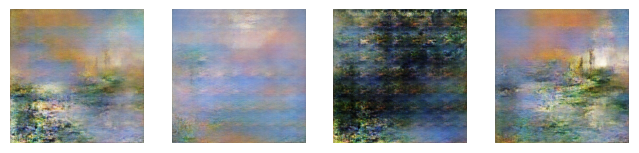

Epoch 880, gen_loss=4.3835, disc_loss=0.3202, time=3.53 sec


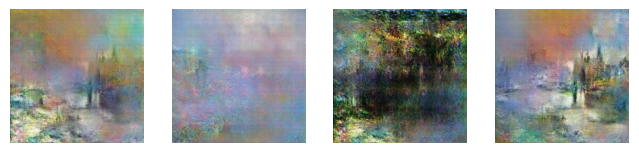

Epoch 900, gen_loss=3.4569, disc_loss=0.3486, time=3.53 sec


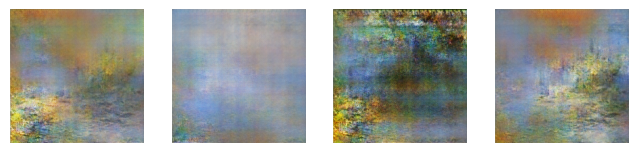

Epoch 920, gen_loss=3.9151, disc_loss=0.3201, time=3.54 sec


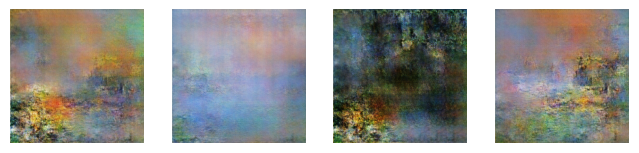

Epoch 940, gen_loss=3.8466, disc_loss=0.2633, time=3.54 sec


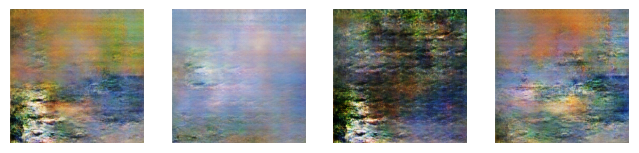

Epoch 960, gen_loss=3.9739, disc_loss=0.3490, time=3.54 sec


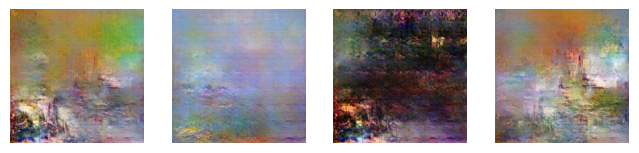

Epoch 980, gen_loss=4.0610, disc_loss=0.3503, time=3.53 sec


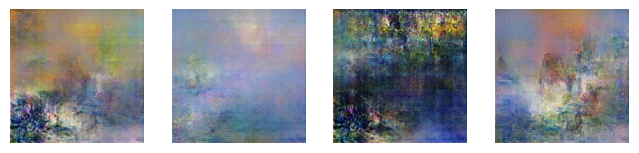

Epoch 1000, gen_loss=3.9868, disc_loss=0.3164, time=3.53 sec


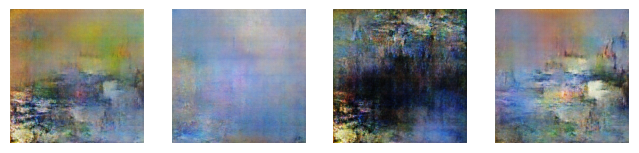

Epoch 1020, gen_loss=4.2323, disc_loss=0.4138, time=3.54 sec


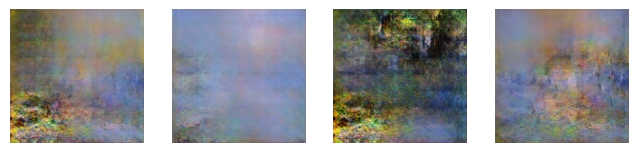

Epoch 1040, gen_loss=4.0188, disc_loss=0.3589, time=3.56 sec


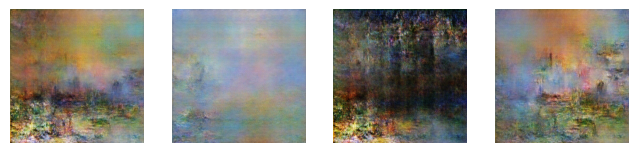

Epoch 1060, gen_loss=4.9664, disc_loss=0.3420, time=3.53 sec


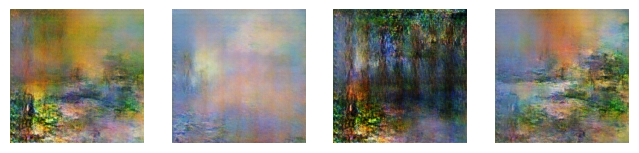

Epoch 1080, gen_loss=4.1223, disc_loss=0.2973, time=3.53 sec


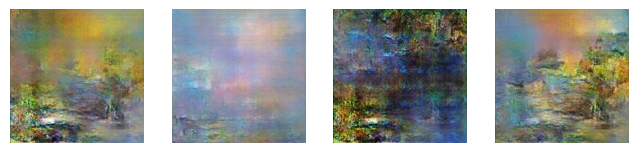

Epoch 1100, gen_loss=5.4816, disc_loss=0.4521, time=3.53 sec


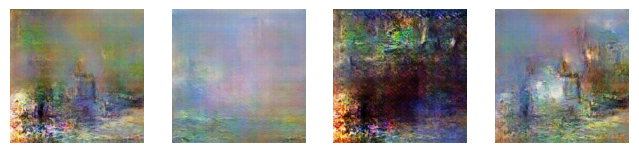

Epoch 1120, gen_loss=4.3091, disc_loss=0.2568, time=3.52 sec


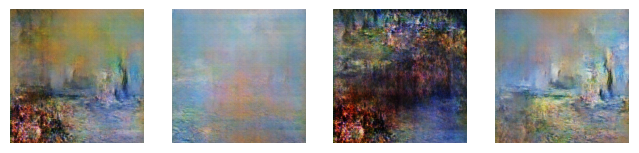

Epoch 1140, gen_loss=4.8036, disc_loss=0.2721, time=3.54 sec


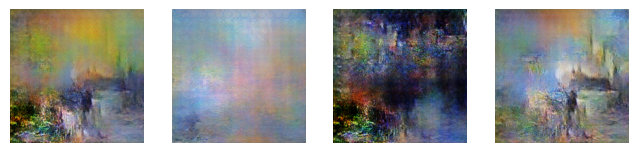

Epoch 1160, gen_loss=4.9106, disc_loss=0.2557, time=3.54 sec


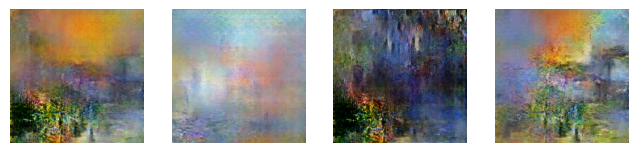

Epoch 1180, gen_loss=4.4742, disc_loss=0.2179, time=3.53 sec


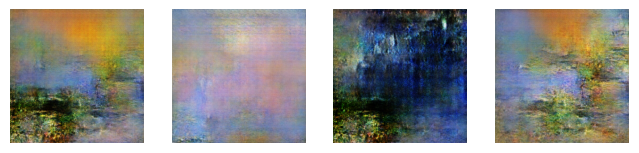

Epoch 1200, gen_loss=6.5903, disc_loss=0.2976, time=3.54 sec


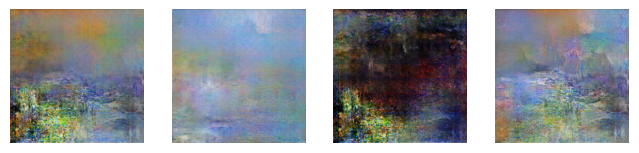

Epoch 1220, gen_loss=5.8752, disc_loss=1.2566, time=3.56 sec


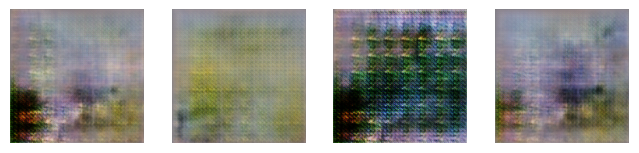

Epoch 1240, gen_loss=2.9714, disc_loss=0.8914, time=3.53 sec


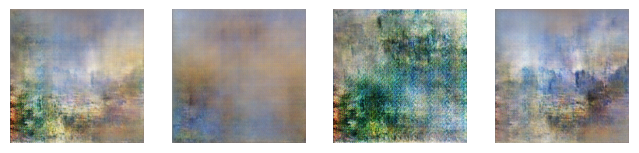

Epoch 1260, gen_loss=3.1483, disc_loss=0.7332, time=3.53 sec


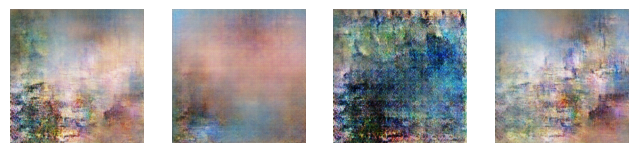

Epoch 1280, gen_loss=3.1178, disc_loss=0.6256, time=3.54 sec


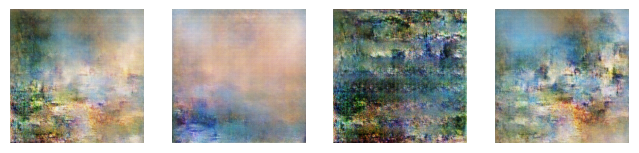

Epoch 1300, gen_loss=3.3315, disc_loss=0.4994, time=3.59 sec


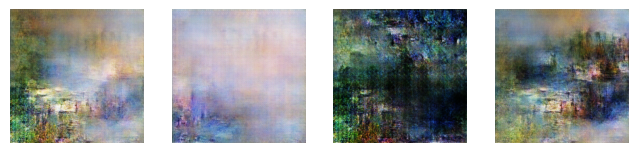

Epoch 1320, gen_loss=3.3388, disc_loss=0.4440, time=3.53 sec


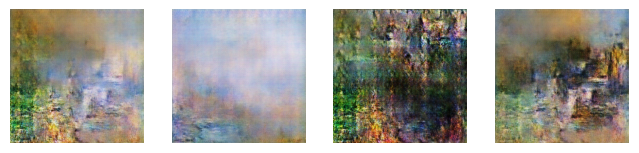

Epoch 1340, gen_loss=3.6805, disc_loss=0.5103, time=3.52 sec


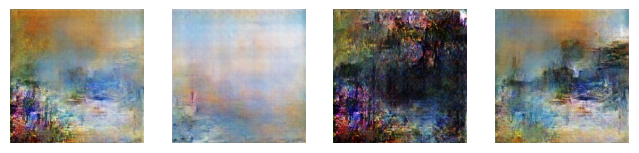

Epoch 1360, gen_loss=3.5718, disc_loss=0.6984, time=3.53 sec


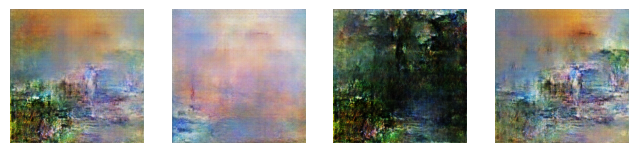

Epoch 1380, gen_loss=4.7250, disc_loss=0.3980, time=3.53 sec


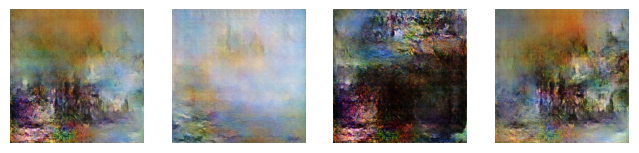

Epoch 1400, gen_loss=3.4274, disc_loss=0.3439, time=3.53 sec


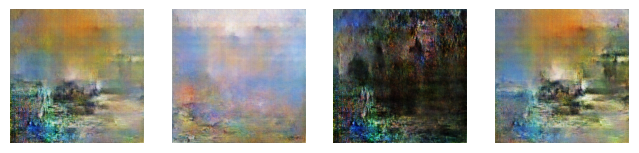

Epoch 1420, gen_loss=3.7162, disc_loss=0.4912, time=3.53 sec


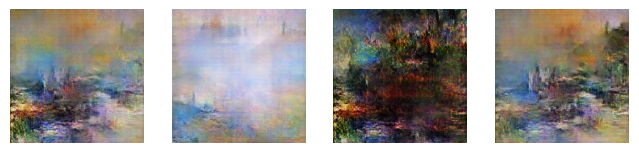

Epoch 1440, gen_loss=3.8322, disc_loss=0.4013, time=3.53 sec


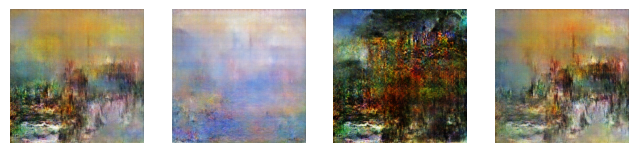

Epoch 1460, gen_loss=5.0710, disc_loss=0.4510, time=3.53 sec


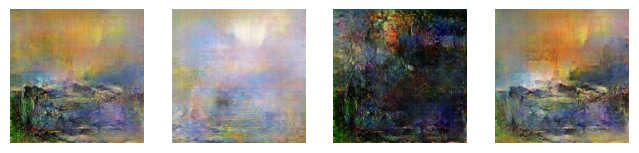

Epoch 1480, gen_loss=4.6287, disc_loss=0.3470, time=3.53 sec


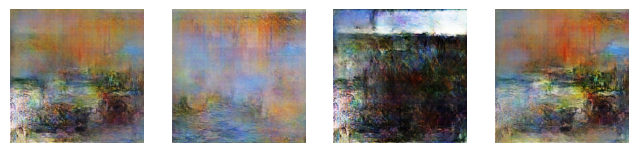

Epoch 1500, gen_loss=4.6495, disc_loss=0.3004, time=3.53 sec


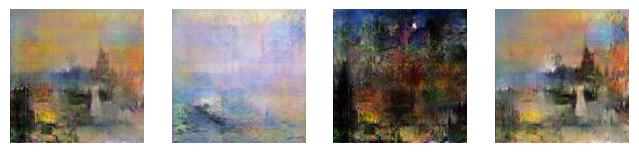

In [12]:
# Generator model
def make_generator_model():
    model = tf.keras.Sequential([
        layers.Dense(8*8*1024, use_bias=False, input_shape=(100,)),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Reshape((8, 8, 1024)),
        layers.Conv2DTranspose(512, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
    ])
    return model

# Discriminator model
def make_discriminator_model():
    model = tf.keras.Sequential([
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[256, 256, 3]),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Flatten(),
        layers.Dense(1)
    ])
    return model

# Define loss functions
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

@tf.function
def train_step(images, generator, discriminator, generator_optimizer, discriminator_optimizer):
    noise = tf.random.normal([tf.shape(images)[0], 100])  # Use dynamic sizing for batch size

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    return gen_loss, disc_loss

def train(dataset, epochs, generator, discriminator, generator_optimizer, discriminator_optimizer):
    for epoch in range(epochs):
        start = time.time()
        
        gen_loss_list = []
        disc_loss_list = []

        for image_batch in dataset:
            gen_loss, disc_loss = train_step(image_batch, generator, discriminator, generator_optimizer, discriminator_optimizer)
            gen_loss_list.append(gen_loss)
            disc_loss_list.append(disc_loss)

        gen_loss_avg = tf.reduce_mean(gen_loss_list)
        disc_loss_avg = tf.reduce_mean(disc_loss_list)
        
        #print(f'Epoch {epoch+1}, gen_loss={gen_loss_avg:.4f}, disc_loss={disc_loss_avg:.4f}, time={time.time()-start:.2f} sec')

        if (epoch + 1) == 1 or (epoch + 1) % 20 == 0:
            print(f'Epoch {epoch+1}, gen_loss={gen_loss_avg:.4f}, disc_loss={disc_loss_avg:.4f}, time={time.time()-start:.2f} sec')
            generate_and_save_images(generator, epoch + 1, seed)

def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(8, 8))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        img = (predictions[i, :, :, :] * 127.5 + 127.5).numpy().astype('uint8')
        plt.imshow(img)
        plt.axis('off')

    plt.show()

BATCH_SIZE = 32
tfrecord_files = [
    Input + '/monet_tfrec/monet00-60.tfrec',
    Input + '/monet_tfrec/monet04-60.tfrec',
    Input + '/monet_tfrec/monet08-60.tfrec',
    Input + '/monet_tfrec/monet12-60.tfrec',
    Input + '/monet_tfrec/monet16-60.tfrec'
]
dataset = load_dataset(tfrecord_files, BATCH_SIZE)

generator = make_generator_model()
discriminator = make_discriminator_model()

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

num_examples_to_generate = 4
seed = tf.random.normal([num_examples_to_generate, 100])

# Start Training
train(dataset, 1500, generator, discriminator, generator_optimizer, discriminator_optimizer)


In [17]:
def generate_and_save_images(model, total_images, directory, batch_size=10):
    if not os.path.exists(directory):
        os.makedirs(directory)  # Ensure the directory exists

    for batch_start in range(0, total_images, batch_size):
        batch_end = min(batch_start + batch_size, total_images)
        num_images = batch_end - batch_start
        noise = tf.random.normal([num_images, 100])  # Generate different noises for each batch
        predictions = model(noise, training=False)

        for i, img in enumerate(predictions):
            img = (img * 127.5 + 127.5).numpy().astype('uint8')
            image = Image.fromarray(img)
            image.save(f"{directory}/image_{batch_start+i+1:03d}.jpg", 'JPEG')  # Save each image as JPEG

            # Directory where images will be saved
output_dir = '../images'

# After training, generate and save 100 images in JPEG format
generate_and_save_images(generator, 7000, output_dir)

In [19]:
# See that all created images are inside the images folder
# !ls ../images

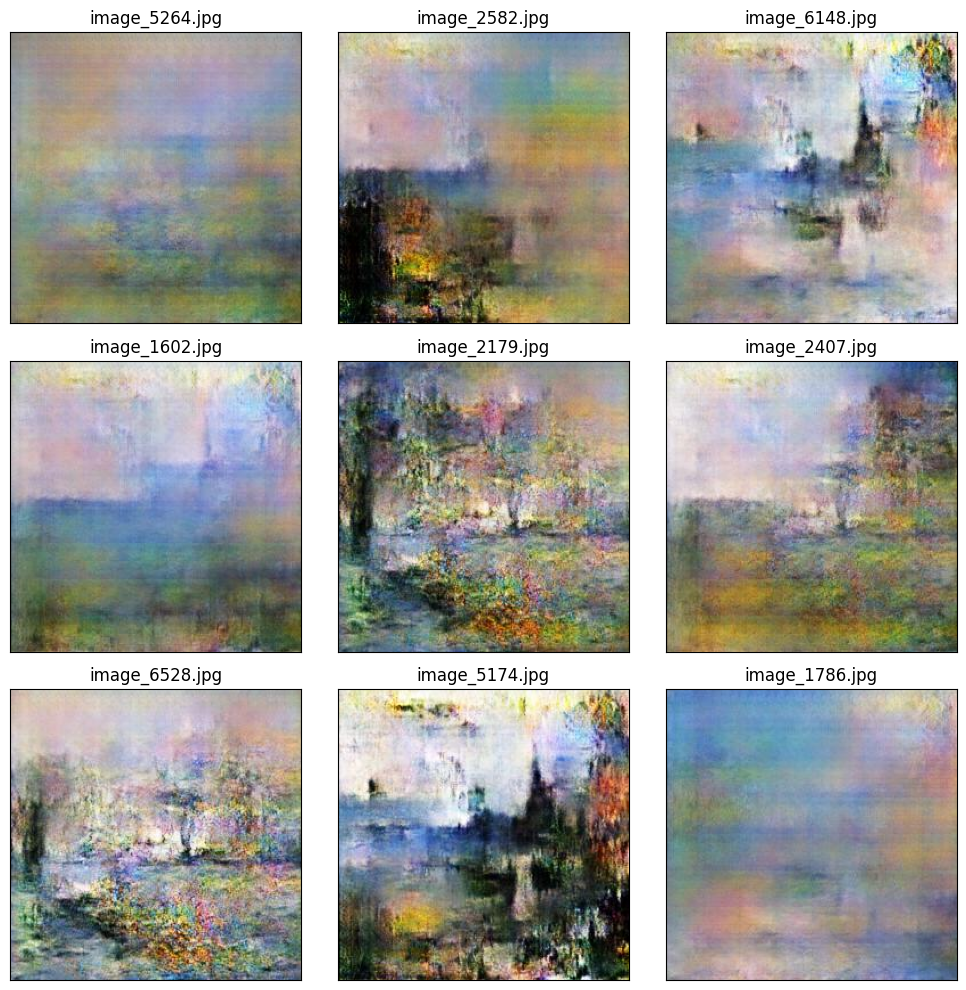

In [20]:
# Display some generated images
path = '../images'
display_images(path)

In [21]:
# Create zip-file
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'

In [22]:
!ls

images.zip


<div style="background-color:#5BC0BE; padding: 15px; border-radius: 8px; border: 2px solid #0B132B; margin-top: 20px;">
    <h3 style="color: #0B132B; text-align: left; font-size: 22px; margin-top: 0;">Conclusion</h3>
</div>

In this assignment, we have seen that it is possible to build an GAN model that can produce Monet-style paintings. However, with the training time used in this project, it not difficult for a human to distinguish a real from a fake Monet. The GAN gets the colors right, but the figurative aspects of the paintings are wrong or missing. More training time could perhaps have improved the figurative aspects of the paintings. But it is far from certain that the GAN would have been able to learn these aspects of the Monet-style. 

We chose to create a DCGAN that created the images from scratch (so to speak) rather than training a cycle GAN that could style pictures. It would have been interesting to compare the two approaches, but that falls outside the scope of this mini-project.  